In [7]:
%matplotlib inline

# install pillow
!pip install Pillow -U

# download and unzip dataset o train
!wget http://images.cocodataset.org/zips/val2014.zip
!mkdir train
%cd /content/train
!unzip -qq /content/val2014.zip
%cd ..

#download model
!wget https://web.eecs.umich.edu/~justincj/models/vgg16-00b39a1b.pth

     |████████████████████████████████| 4.3 MB 14.5 MB/s 
  Attempting uninstall: Pillow
    Found existing installation: Pillow 7.1.2
    Uninstalling Pillow-7.1.2:
      Successfully uninstalled Pillow-7.1.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.


--2022-05-05 17:06:17--  http://images.cocodataset.org/zips/val2014.zip
Resolving images.cocodataset.org (images.cocodataset.org)... 52.217.163.169
Connecting to images.cocodataset.org (images.cocodataset.org)|52.217.163.169|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 6645013297 (6.2G) [application/zip]
Saving to: ‘val2014.zip’

val2014.zip         100%[===================>]   6.19G  34.9MB/s    in 3m 4s   

2022-05-05 17:09:22 (34.4 MB/s) - ‘val2014.zip’ saved [6645013297/6645013297]

/content/train
/content
--2022-05-05 17:10:02--  https://web.eecs.umich.edu/~justincj/models/vgg16-00b39a1b.pth
Resolving web.eecs.umich.edu (web.eecs.umich.edu)... 141.212.113.214
Connecting to web.eecs.umich.edu (web.eecs.umich.edu)|141.212.113.214|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 553451520 (528M) [application/x-tar]
Saving to: ‘vgg16-00b39a1b.pth’

vgg16-00b39a1b.pth  100%[===================>] 527.81M  29.2MB/s    in 19s     

2022

In [8]:
!pip install --ignore-installed Pillow==9.0.0

     |████████████████████████████████| 4.3 MB 14.2 MB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.


In [1]:
import PIL
from PIL import Image
import matplotlib.pyplot as plt
import os
import cv2
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import datasets, transforms, models
import random
import numpy as np
import time
import vgg16_fe as vgg # this is used to extract features
import vgg16 as vgg_model # this is used to train the model
import utils

In [2]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


# Trained on COCO dataset for VGG16 Model for different styles


## Rain Princess

In [14]:
# Global variables
TRAIN_IMAGE_SIZE = 256
DATASET_PATH = "train"
NUM_EPOCHS = 1
STYLE_IMAGE_PATH = "style/rain_princess.jpg"
BATCH_SIZE = 4 
CONTENT_WEIGHT = 10 # 17
STYLE_WEIGHT = 25 # 25
ADAM_LR = 0.001
SAVE_MODEL_PATH = "rain_princess/models/"
SAVE_IMAGE_PATH = "rain_princess/images/"
SAVE_MODEL_EVERY = 500 # 2,000 Images with batch size 4
SEED = 35
PLOT_LOSS = 1

In [15]:
def train():
    # seeds
    torch.manual_seed(SEED)
    torch.cuda.manual_seed(SEED)
    np.random.seed(SEED)
    random.seed(SEED)

    # get the device
    device = ("cuda" if torch.cuda.is_available() else "cpu")

    # load the training dataset
    transform = transforms.Compose([
        transforms.Resize(TRAIN_IMAGE_SIZE),
        transforms.CenterCrop(TRAIN_IMAGE_SIZE),
        transforms.ToTensor(),
        transforms.Lambda(lambda x: x.mul(255))
    ])

    train_dataset = datasets.ImageFolder(DATASET_PATH, transform=transform)
    train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)

    # load the models and start training :)
    model = vgg_model.VGG16('/content/vgg16-00b39a1b.pth').to(device) #Creating a pretrained model object by loading the downloaded .pth file. This model object will be retrained 
    vgg16_fe = vgg.VGG16('/content/vgg16-00b39a1b.pth').to(device) #Creating a pretrained model object by loading the downloaded .pth file. This model object will be used to extract features and will not be retrained

    # get style features
    imagenet_neg_mean = torch.tensor([-103.939, -116.779, -123.68], dtype=torch.float32).reshape(1,3,1,1).to(device)
    # load the style image
    style_image = utils.load_image(STYLE_IMAGE_PATH)
    # convert style image to tensor
    style_tensor = utils.itot(style_image).to(device)
    # add imagenet mean
    style_tensor = style_tensor.add(imagenet_neg_mean)

    B, C, H, W = style_tensor.shape
    # get the features of the style image
    style_features = vgg16_fe(style_tensor.expand([BATCH_SIZE, C, H, W]))

    # get the gram matrix of the style image
    style_gram = {}
    for key, value in style_features.items():
        style_gram[key] = utils.gram(value)

    # Optimizer settings
    optimizer = optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=ADAM_LR)

    # Loss trackers
    content_loss_history = []
    style_loss_history = []
    total_loss_history = []
    batch_content_loss_sum = 0
    batch_style_loss_sum = 0
    batch_total_loss_sum = 0

    # Optimization/Training Loop
    batch_count = 1
    start_time = time.time()

    # training loop
    for epoch in range(NUM_EPOCHS):
        print("========Epoch {}/{}========".format(epoch+1, NUM_EPOCHS))
        for content_batch, _ in train_loader:
            # Get current batch size in case of odd batch sizes
            curr_batch_size = content_batch.shape[0]

            # free up unnecessary memory of cuda
            torch.cuda.empty_cache()

            # zero the gradients
            optimizer.zero_grad()

            # Generate images and get features
            content_batch = content_batch[:,[2,1,0]].to(device)
            generated_batch = model(content_batch)

            # print("Content Batch: ", content_batch.shape)
            # print("Generated Batch: ", generated_batch.shape)

            content_features = vgg16_fe(content_batch.add(imagenet_neg_mean))
            generated_features = vgg16_fe(generated_batch.add(imagenet_neg_mean))

            # print("Generated Features:", generated_features['relu2_2'].shape)
            # print("Content Features:", content_features['relu2_2'].shape)

            # Calculate content loss
            MSELoss = nn.MSELoss().to(device)
            content_loss = CONTENT_WEIGHT * MSELoss(generated_features['relu2_2'], content_features['relu2_2'])            
            batch_content_loss_sum += content_loss

            # Calculate style loss
            style_loss = 0
            for key, value in generated_features.items():
                s_loss = MSELoss(utils.gram(value), style_gram[key][:curr_batch_size])
                style_loss += s_loss
            style_loss *= STYLE_WEIGHT
            batch_style_loss_sum += style_loss.item()

            # Calculate total loss
            total_loss = content_loss + style_loss
            batch_total_loss_sum += total_loss.item()

            # Backpropagation
            total_loss.backward()
            optimizer.step()

            # Save Model and Print Losses
            if (((batch_count-1)%SAVE_MODEL_EVERY == 0) or (batch_count==NUM_EPOCHS*len(train_loader))):
                # Print Losses
                print("========Iteration {}/{}========".format(batch_count, NUM_EPOCHS*len(train_loader)))
                print("\tContent Loss:\t{:.2f}".format(batch_content_loss_sum/batch_count))
                print("\tStyle Loss:\t{:.2f}".format(batch_style_loss_sum/batch_count))
                print("\tTotal Loss:\t{:.2f}".format(batch_total_loss_sum/batch_count))
                print("Time elapsed:\t{} seconds".format(time.time()-start_time))

                # Save Model
                checkpoint_path = SAVE_MODEL_PATH + "checkpoint_" + str(batch_count-1) + ".pth"
                torch.save(model.state_dict(), checkpoint_path)
                
                print("Saved self trained VGG16 checkpoint file at {}".format(checkpoint_path))

                # Save sample generated image
                sample_tensor = generated_batch[0].clone().detach().unsqueeze(dim=0) # clone to save inplace errors
                sample_image = utils.ttoi(sample_tensor.clone().detach())
                sample_image_path = SAVE_IMAGE_PATH + "sample0_" + str(batch_count-1) + ".png"
                utils.saveimg(sample_image, sample_image_path)
                utils.show(sample_image)
                print("Saved sample stylized image at {}".format(sample_image_path))

                # Save loss histories
                content_loss_history.append(batch_total_loss_sum/batch_count)
                style_loss_history.append(batch_style_loss_sum/batch_count)
                total_loss_history.append(batch_total_loss_sum/batch_count)
            
            # increment batch count
            batch_count += 1
    
    stop_time = time.time()
    # Print loss histories
    print("Done Training the Network!")
    print("Training Time: {} seconds".format(stop_time-start_time))
    print("========Content Loss========")
    print(content_loss_history) 
    print("========Style Loss========")
    print(style_loss_history) 
    print("========Total Loss========")
    print(total_loss_history) 

    # Save TransformerNetwork weights
    model.eval()
    model.cpu()
    final_path = SAVE_MODEL_PATH + "transformer_weight.pth"
    print("Saving VGG16 weights at {}".format(final_path))
    torch.save(model.state_dict(), final_path)
    print("Done saving final model")

    # Plot Loss Histories
    if (PLOT_LOSS):
        utils.plot_loss_hist(content_loss_history, style_loss_history, total_loss_history)


### Training

========Epoch 1/1========
========Iteration 1/10126========
	Content Loss:	1307065.25
	Style Loss:	36810940.00
	Total Loss:	38118004.00
Time elapsed:	0.38347601890563965 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_0.pth


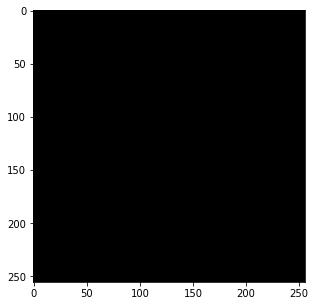

Saved sample stylized image at rain_princess/images/sample0_0.png
========Iteration 501/10126========
	Content Loss:	3451607.00
	Style Loss:	4331010.38
	Total Loss:	7782617.31
Time elapsed:	38.58956575393677 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_500.pth


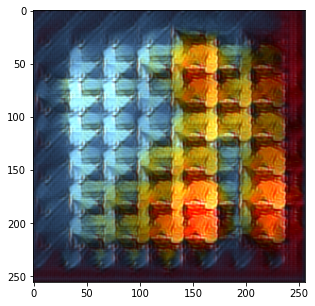

Saved sample stylized image at rain_princess/images/sample0_500.png
========Iteration 1001/10126========
	Content Loss:	3492626.50
	Style Loss:	2375595.04
	Total Loss:	5868219.78
Time elapsed:	77.04628276824951 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_1000.pth


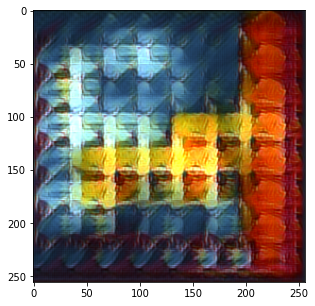

Saved sample stylized image at rain_princess/images/sample0_1000.png
========Iteration 1501/10126========
	Content Loss:	3476387.25
	Style Loss:	1695183.87
	Total Loss:	5171569.89
Time elapsed:	115.31828045845032 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_1500.pth


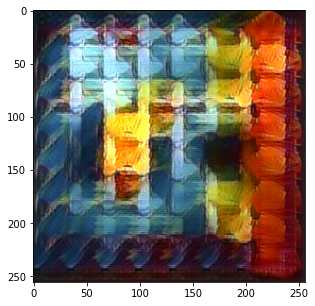

Saved sample stylized image at rain_princess/images/sample0_1500.png
========Iteration 2001/10126========
	Content Loss:	3449437.50
	Style Loss:	1350036.41
	Total Loss:	4799473.23
Time elapsed:	153.51127767562866 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_2000.pth


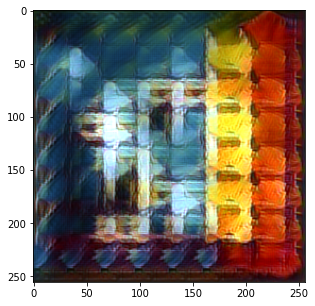

Saved sample stylized image at rain_princess/images/sample0_2000.png
========Iteration 2501/10126========
	Content Loss:	3423507.50
	Style Loss:	1141704.30
	Total Loss:	4565213.15
Time elapsed:	191.93883228302002 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_2500.pth


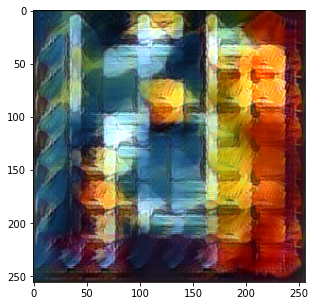

Saved sample stylized image at rain_princess/images/sample0_2500.png
========Iteration 3001/10126========
	Content Loss:	3398430.00
	Style Loss:	1002884.27
	Total Loss:	4401315.27
Time elapsed:	230.40384912490845 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_3000.pth


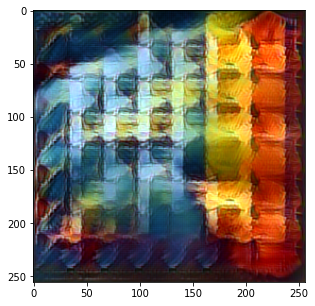

Saved sample stylized image at rain_princess/images/sample0_3000.png
========Iteration 3501/10126========
	Content Loss:	3376620.50
	Style Loss:	903811.24
	Total Loss:	4280435.20
Time elapsed:	268.58187317848206 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_3500.pth


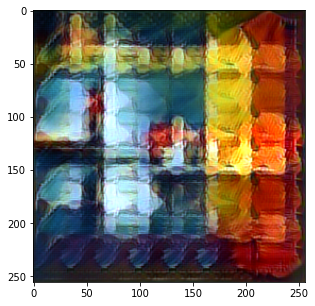

Saved sample stylized image at rain_princess/images/sample0_3500.png
========Iteration 4001/10126========
	Content Loss:	3356514.75
	Style Loss:	829733.58
	Total Loss:	4186251.61
Time elapsed:	307.09935879707336 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_4000.pth


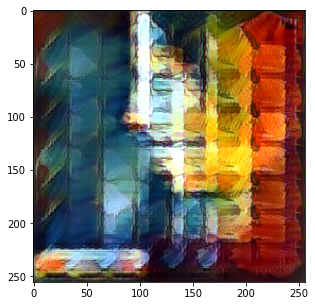

Saved sample stylized image at rain_princess/images/sample0_4000.png
========Iteration 4501/10126========
	Content Loss:	3337347.00
	Style Loss:	772307.44
	Total Loss:	4109660.15
Time elapsed:	345.2565817832947 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_4500.pth


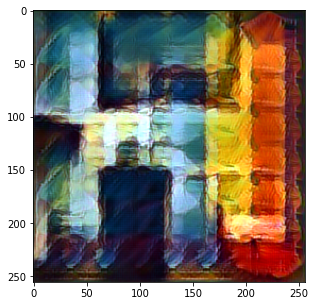

Saved sample stylized image at rain_princess/images/sample0_4500.png
========Iteration 5001/10126========
	Content Loss:	3316596.00
	Style Loss:	726190.00
	Total Loss:	4042792.36
Time elapsed:	383.76798844337463 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_5000.pth


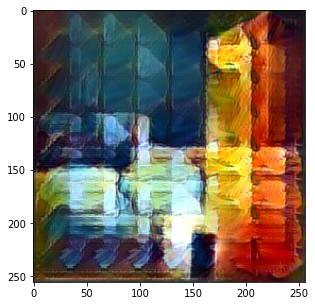

Saved sample stylized image at rain_princess/images/sample0_5000.png
========Iteration 5501/10126========
	Content Loss:	3298839.50
	Style Loss:	688585.78
	Total Loss:	3987429.55
Time elapsed:	423.3029646873474 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_5500.pth


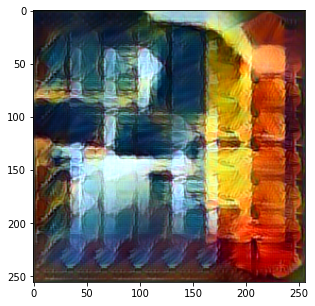

Saved sample stylized image at rain_princess/images/sample0_5500.png
========Iteration 6001/10126========
	Content Loss:	3281418.00
	Style Loss:	657440.22
	Total Loss:	3938863.14
Time elapsed:	463.1019823551178 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_6000.pth


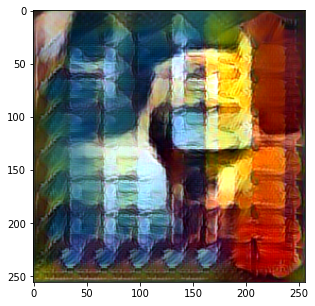

Saved sample stylized image at rain_princess/images/sample0_6000.png
========Iteration 6501/10126========
	Content Loss:	3267966.00
	Style Loss:	631174.79
	Total Loss:	3899148.36
Time elapsed:	502.3742642402649 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_6500.pth


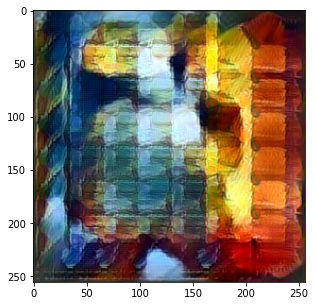

Saved sample stylized image at rain_princess/images/sample0_6500.png
========Iteration 7001/10126========
	Content Loss:	3253627.25
	Style Loss:	608598.57
	Total Loss:	3862234.25
Time elapsed:	541.5038585662842 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_7000.pth


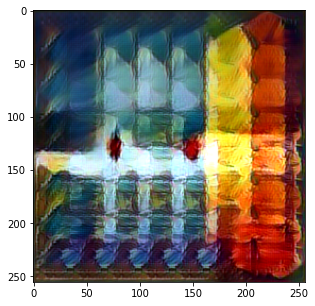

Saved sample stylized image at rain_princess/images/sample0_7000.png
========Iteration 7501/10126========
	Content Loss:	3239981.75
	Style Loss:	589040.09
	Total Loss:	3829033.01
Time elapsed:	580.0640869140625 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_7500.pth


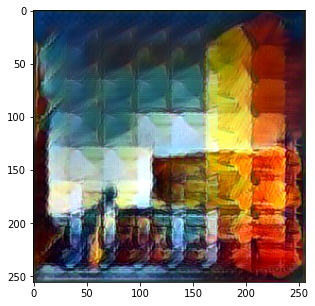

Saved sample stylized image at rain_princess/images/sample0_7500.png
========Iteration 8001/10126========
	Content Loss:	3227182.75
	Style Loss:	571947.56
	Total Loss:	3799141.72
Time elapsed:	618.4406552314758 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_8000.pth


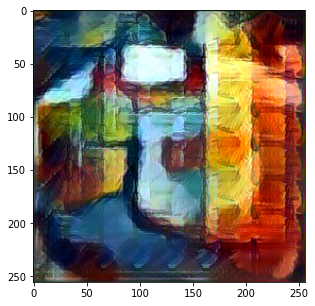

Saved sample stylized image at rain_princess/images/sample0_8000.png
========Iteration 8501/10126========
	Content Loss:	3213923.75
	Style Loss:	556823.66
	Total Loss:	3770759.40
Time elapsed:	664.4468882083893 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_8500.pth


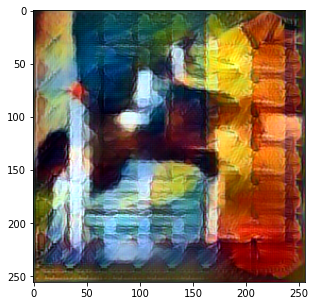

Saved sample stylized image at rain_princess/images/sample0_8500.png
========Iteration 9001/10126========
	Content Loss:	3202994.00
	Style Loss:	543366.95
	Total Loss:	3746373.29
Time elapsed:	714.9301776885986 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_9000.pth


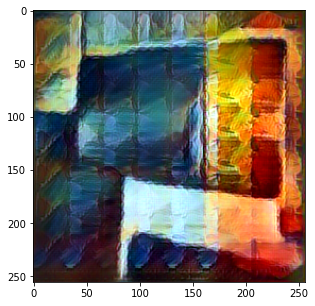

Saved sample stylized image at rain_princess/images/sample0_9000.png
========Iteration 9501/10126========
	Content Loss:	3193283.00
	Style Loss:	531424.26
	Total Loss:	3724718.96
Time elapsed:	764.4579467773438 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_9500.pth


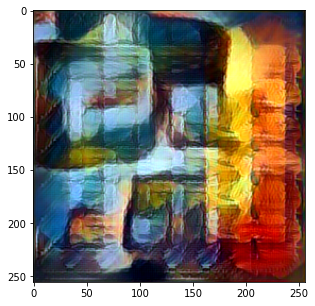

Saved sample stylized image at rain_princess/images/sample0_9500.png
========Iteration 10001/10126========
	Content Loss:	3183022.25
	Style Loss:	520495.86
	Total Loss:	3703530.97
Time elapsed:	813.4671995639801 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_10000.pth


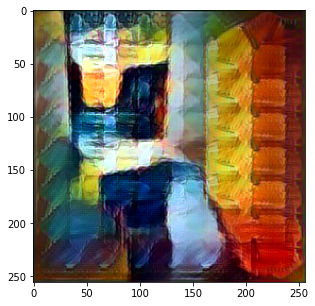

Saved sample stylized image at rain_princess/images/sample0_10000.png
========Iteration 10126/10126========
	Content Loss:	3180884.75
	Style Loss:	517986.79
	Total Loss:	3698884.19
Time elapsed:	825.9470202922821 seconds
Saved self trained VGG16 checkpoint file at rain_princess/models/checkpoint_10125.pth


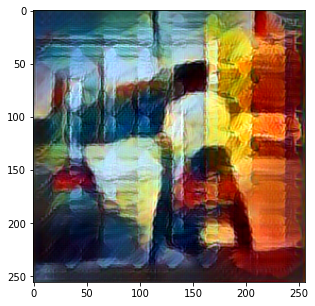

Saved sample stylized image at rain_princess/images/sample0_10125.png
Done Training the Network!
Training Time: 826.350344657898 seconds
========Content Loss========
[38118004.0, 7782617.305389222, 5868219.777972028, 5171569.891072618, 4799473.232758621, 4565213.150339864, 4401315.272659114, 4280435.199728649, 4186251.6118470384, 4109660.1485225507, 4042792.3600779846, 3987429.5534448284, 3938863.139643393, 3899148.3613290265, 3862234.2533209543, 3829033.0137648312, 3799141.7249406325, 3770759.4013057286, 3746373.288023553, 3724718.9607672878, 3703530.971177882, 3698884.191931661]
========Style Loss========
[36810940.0, 4331010.384792915, 2375595.038711289, 1695183.8660580446, 1350036.4085223014, 1141704.3013482108, 1002884.2664216094, 903811.2430198515, 829733.5763520057, 772307.4353824151, 726190.0037961158, 688585.7788214643, 657440.2175731128, 631174.7936976042, 608598.5655888445, 589040.0910420277, 571947.5588735002, 556823.6600344812, 543366.9452265721, 531424.2574317835, 520495.

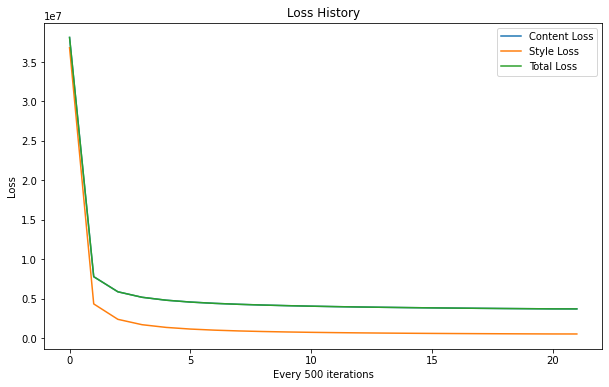

In [16]:
train()

In [17]:
# copy the models folder to the folder in the google drive
!cp -r rain_princess/models/ /content/gdrive/My\ Drive/vgg_coco/rain_princess/
# copy the images folder to the folder in the google drive
!cp -r rain_princess/images/ /content/gdrive/My\ Drive/vgg_coco/rain_princess/

## The Scream

In [18]:
# Global variables
TRAIN_IMAGE_SIZE = 256
DATASET_PATH = "train"
NUM_EPOCHS = 1
STYLE_IMAGE_PATH = "style/the_scream.jpg"
BATCH_SIZE = 4 
CONTENT_WEIGHT = 10 # 17
STYLE_WEIGHT = 25 # 25
ADAM_LR = 0.001
SAVE_MODEL_PATH = "the_scream/models/"
SAVE_IMAGE_PATH = "the_scream/images/"
SAVE_MODEL_EVERY = 500 # 2,000 Images with batch size 4
SEED = 35
PLOT_LOSS = 1

========Epoch 1/1========
========Iteration 1/10126========
	Content Loss:	1307065.25
	Style Loss:	12783927.00
	Total Loss:	14090992.00
Time elapsed:	0.14858555793762207 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_0.pth


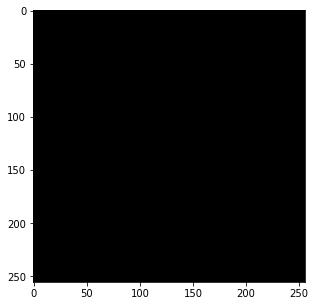

Saved sample stylized image at the_scream/images/sample0_0.png
========Iteration 501/10126========
	Content Loss:	2057860.12
	Style Loss:	1239850.46
	Total Loss:	3297710.98
Time elapsed:	38.37563228607178 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_500.pth


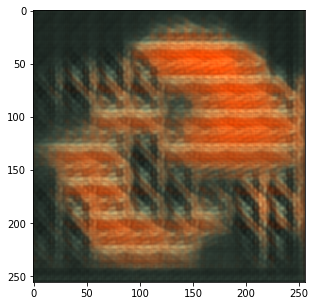

Saved sample stylized image at the_scream/images/sample0_500.png
========Iteration 1001/10126========
	Content Loss:	2041775.62
	Style Loss:	694553.63
	Total Loss:	2736329.45
Time elapsed:	76.84165263175964 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_1000.pth


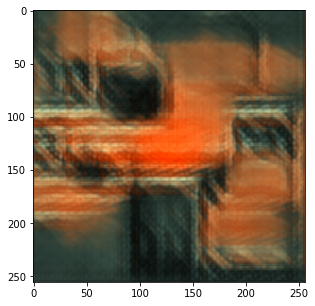

Saved sample stylized image at the_scream/images/sample0_1000.png
========Iteration 1501/10126========
	Content Loss:	2004189.75
	Style Loss:	511750.67
	Total Loss:	2515939.24
Time elapsed:	114.99677968025208 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_1500.pth


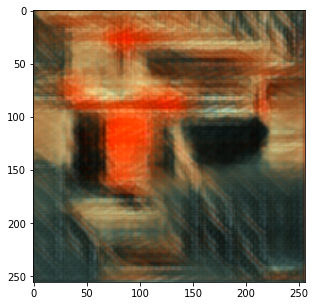

Saved sample stylized image at the_scream/images/sample0_1500.png
========Iteration 2001/10126========
	Content Loss:	1966900.00
	Style Loss:	419802.25
	Total Loss:	2386701.90
Time elapsed:	152.99055814743042 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_2000.pth


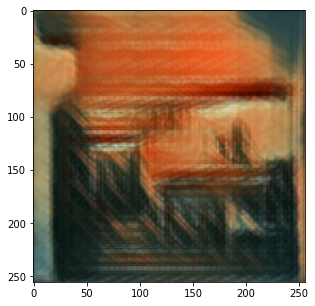

Saved sample stylized image at the_scream/images/sample0_2000.png
========Iteration 2501/10126========
	Content Loss:	1938227.25
	Style Loss:	363680.30
	Total Loss:	2301905.99
Time elapsed:	191.33925199508667 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_2500.pth


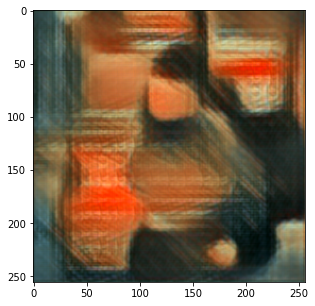

Saved sample stylized image at the_scream/images/sample0_2500.png
========Iteration 3001/10126========
	Content Loss:	1914200.88
	Style Loss:	326055.14
	Total Loss:	2240253.04
Time elapsed:	229.58130741119385 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_3000.pth


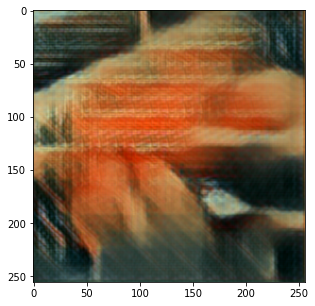

Saved sample stylized image at the_scream/images/sample0_3000.png
========Iteration 3501/10126========
	Content Loss:	1895985.00
	Style Loss:	299116.41
	Total Loss:	2195100.36
Time elapsed:	267.80713152885437 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_3500.pth


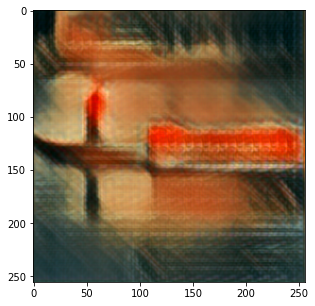

Saved sample stylized image at the_scream/images/sample0_3500.png
========Iteration 4001/10126========
	Content Loss:	1881507.88
	Style Loss:	278626.29
	Total Loss:	2160133.03
Time elapsed:	306.2804856300354 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_4000.pth


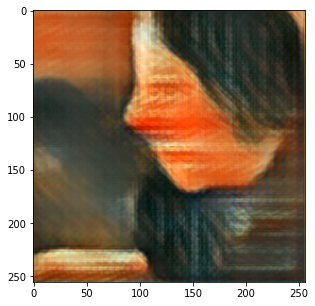

Saved sample stylized image at the_scream/images/sample0_4000.png
========Iteration 4501/10126========
	Content Loss:	1867805.12
	Style Loss:	262676.76
	Total Loss:	2130481.95
Time elapsed:	344.585084438324 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_4500.pth


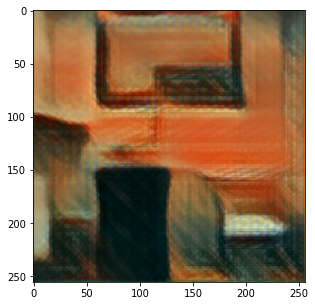

Saved sample stylized image at the_scream/images/sample0_4500.png
========Iteration 5001/10126========
	Content Loss:	1853380.00
	Style Loss:	249639.76
	Total Loss:	2103019.42
Time elapsed:	382.8928244113922 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_5000.pth


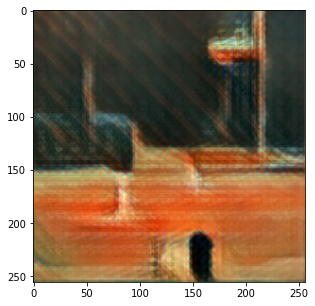

Saved sample stylized image at the_scream/images/sample0_5000.png
========Iteration 5501/10126========
	Content Loss:	1842363.88
	Style Loss:	239011.35
	Total Loss:	2081372.59
Time elapsed:	421.23141646385193 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_5500.pth


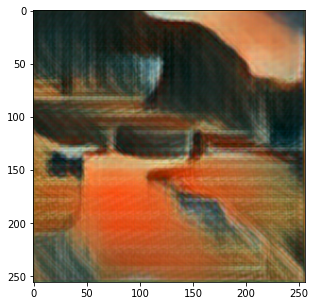

Saved sample stylized image at the_scream/images/sample0_5500.png
========Iteration 6001/10126========
	Content Loss:	1830995.62
	Style Loss:	230167.05
	Total Loss:	2061158.29
Time elapsed:	459.5075218677521 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_6000.pth


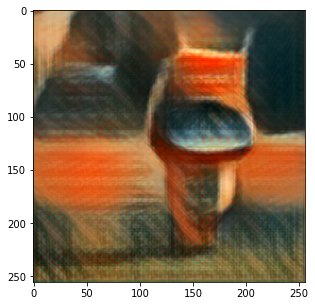

Saved sample stylized image at the_scream/images/sample0_6000.png
========Iteration 6501/10126========
	Content Loss:	1823916.12
	Style Loss:	222587.78
	Total Loss:	2046499.71
Time elapsed:	497.9822783470154 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_6500.pth


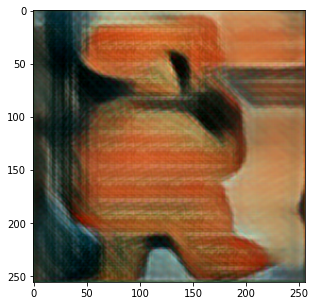

Saved sample stylized image at the_scream/images/sample0_6500.png
========Iteration 7001/10126========
	Content Loss:	1815605.25
	Style Loss:	216048.00
	Total Loss:	2031649.12
Time elapsed:	536.0361411571503 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_7000.pth


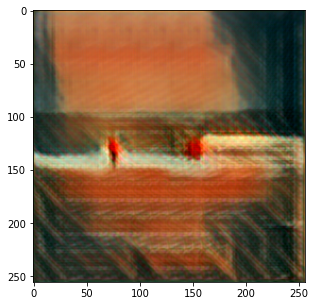

Saved sample stylized image at the_scream/images/sample0_7000.png
========Iteration 7501/10126========
	Content Loss:	1807656.38
	Style Loss:	210403.99
	Total Loss:	2018056.34
Time elapsed:	574.0888185501099 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_7500.pth


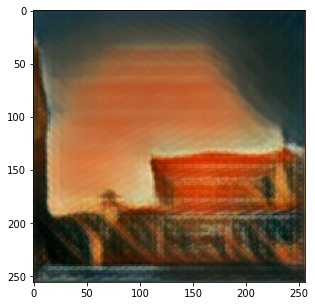

Saved sample stylized image at the_scream/images/sample0_7500.png
========Iteration 8001/10126========
	Content Loss:	1800828.75
	Style Loss:	205448.39
	Total Loss:	2006273.57
Time elapsed:	611.8701324462891 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_8000.pth


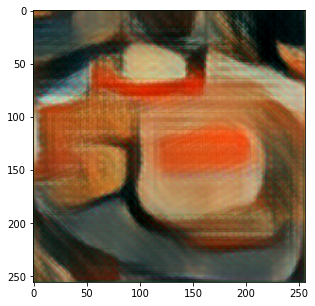

Saved sample stylized image at the_scream/images/sample0_8000.png
========Iteration 8501/10126========
	Content Loss:	1792619.88
	Style Loss:	201064.06
	Total Loss:	1993680.46
Time elapsed:	649.7110199928284 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_8500.pth


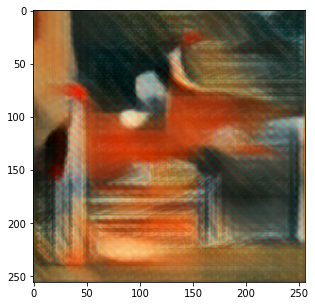

Saved sample stylized image at the_scream/images/sample0_8500.png
========Iteration 9001/10126========
	Content Loss:	1787092.38
	Style Loss:	197166.14
	Total Loss:	1984256.05
Time elapsed:	687.6405482292175 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_9000.pth


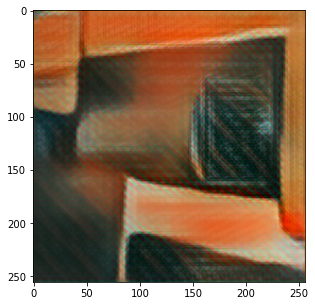

Saved sample stylized image at the_scream/images/sample0_9000.png
========Iteration 9501/10126========
	Content Loss:	1782532.00
	Style Loss:	193660.17
	Total Loss:	1976191.21
Time elapsed:	725.6291937828064 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_9500.pth


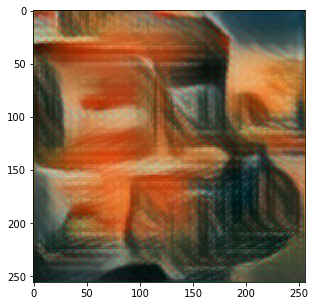

Saved sample stylized image at the_scream/images/sample0_9500.png
========Iteration 10001/10126========
	Content Loss:	1776954.00
	Style Loss:	190496.76
	Total Loss:	1967450.86
Time elapsed:	765.4636104106903 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_10000.pth


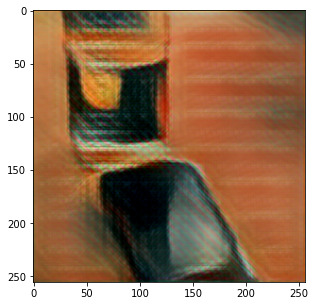

Saved sample stylized image at the_scream/images/sample0_10000.png
========Iteration 10126/10126========
	Content Loss:	1776144.50
	Style Loss:	189757.02
	Total Loss:	1965901.97
Time elapsed:	776.6000657081604 seconds
Saved self trained VGG16 checkpoint file at the_scream/models/checkpoint_10125.pth


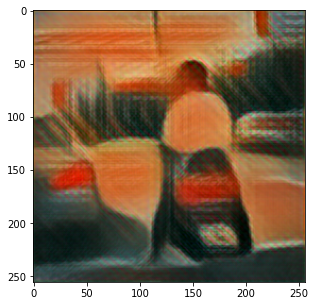

Saved sample stylized image at the_scream/images/sample0_10125.png
Done Training the Network!
Training Time: 776.9605503082275 seconds
========Content Loss========
[14090992.0, 3297710.9757984034, 2736329.4454295705, 2515939.2447534977, 2386701.9017991005, 2301905.986705318, 2240253.0416111294, 2195100.3576121107, 2160133.0251812045, 2130481.954565652, 2103019.4191911616, 2081372.5898927469, 2061158.2861814697, 2046499.7137171205, 2031649.123464505, 2018056.340187975, 2006273.5651481065, 1993680.4557110928, 1984256.0494528385, 1976191.2098200188, 1967450.864238576, 1965901.9658675687]
========Style Loss========
[12783927.0, 1239850.4590662424, 694553.634170517, 511750.6749042305, 419802.25297117064, 363680.3019292283, 326055.1357281948, 299116.40593535773, 278626.28967562795, 262676.75744105474, 249639.75787030093, 239011.34833297355, 230167.05304194093, 222587.782622385, 216047.99556090203, 210403.99149175943, 205448.38932926353, 201064.06142292084, 197166.13961556356, 193660.17200820

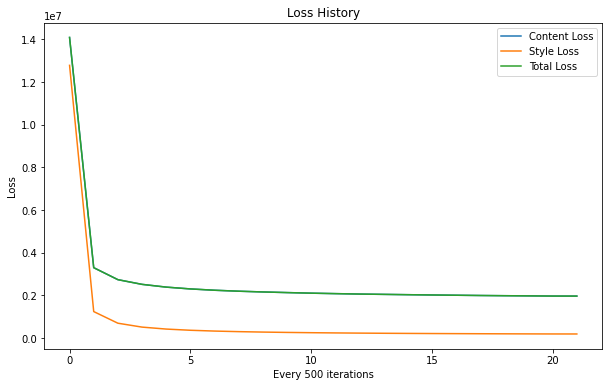

In [19]:
train()

In [20]:
# copy the models folder to the folder in the google drive
!cp -r the_scream/models/ /content/gdrive/My\ Drive/vgg_coco/the_scream/
# copy the images folder to the folder in the google drive
!cp -r the_scream/images/ /content/gdrive/My\ Drive/vgg_coco/the_scream/

## The Shipwreck

In [21]:
# Global variables
TRAIN_IMAGE_SIZE = 256
DATASET_PATH = "train"
NUM_EPOCHS = 1
STYLE_IMAGE_PATH = "style/the_shipwreck.jpg"
BATCH_SIZE = 4 
CONTENT_WEIGHT = 10 # 17
STYLE_WEIGHT = 25 # 25
ADAM_LR = 0.001
SAVE_MODEL_PATH = "the_shipwreck/models/"
SAVE_IMAGE_PATH = "the_shipwreck/images/"
SAVE_MODEL_EVERY = 500 # 2,000 Images with batch size 4
SEED = 35
PLOT_LOSS = 1

========Epoch 1/1========
========Iteration 1/10126========
	Content Loss:	1307065.25
	Style Loss:	10131635.00
	Total Loss:	11438700.00
Time elapsed:	0.22531461715698242 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_0.pth


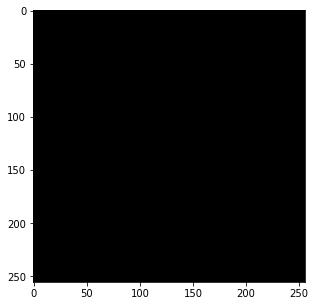

Saved sample stylized image at the_shipwreck/images/sample0_0.png
========Iteration 501/10126========
	Content Loss:	2104311.50
	Style Loss:	817202.70
	Total Loss:	2921514.10
Time elapsed:	39.044626235961914 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_500.pth


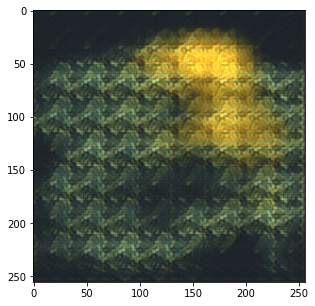

Saved sample stylized image at the_shipwreck/images/sample0_500.png
========Iteration 1001/10126========
	Content Loss:	2086588.62
	Style Loss:	474005.53
	Total Loss:	2560594.33
Time elapsed:	77.39245223999023 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_1000.pth


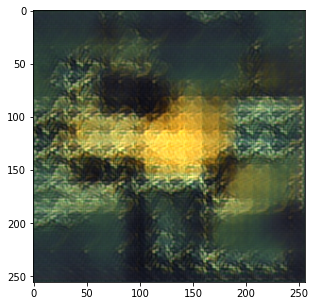

Saved sample stylized image at the_shipwreck/images/sample0_1000.png
========Iteration 1501/10126========
	Content Loss:	2051478.12
	Style Loss:	357731.46
	Total Loss:	2409208.47
Time elapsed:	115.65690445899963 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_1500.pth


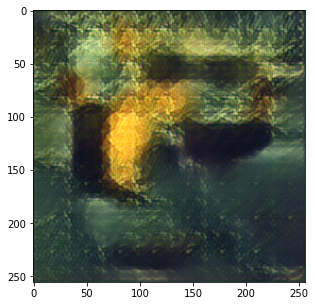

Saved sample stylized image at the_shipwreck/images/sample0_1500.png
========Iteration 2001/10126========
	Content Loss:	2018019.38
	Style Loss:	299156.18
	Total Loss:	2317174.27
Time elapsed:	153.80228638648987 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_2000.pth


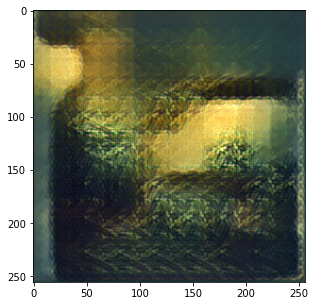

Saved sample stylized image at the_shipwreck/images/sample0_2000.png
========Iteration 2501/10126========
	Content Loss:	1992305.62
	Style Loss:	263754.98
	Total Loss:	2256059.59
Time elapsed:	192.27618384361267 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_2500.pth


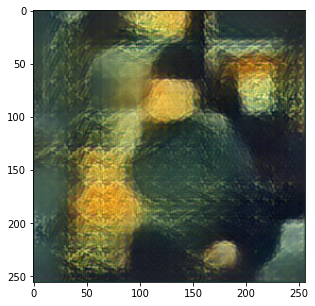

Saved sample stylized image at the_shipwreck/images/sample0_2500.png
========Iteration 3001/10126========
	Content Loss:	1970689.25
	Style Loss:	240005.57
	Total Loss:	2210693.62
Time elapsed:	230.48359966278076 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_3000.pth


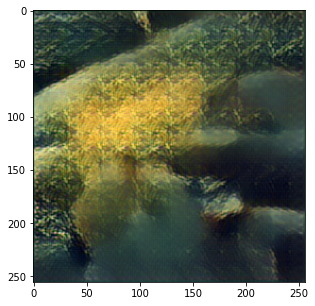

Saved sample stylized image at the_shipwreck/images/sample0_3000.png
========Iteration 3501/10126========
	Content Loss:	1954086.50
	Style Loss:	223021.14
	Total Loss:	2177108.19
Time elapsed:	268.88323044776917 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_3500.pth


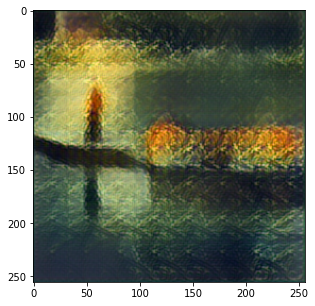

Saved sample stylized image at the_shipwreck/images/sample0_3500.png
========Iteration 4001/10126========
	Content Loss:	1940900.50
	Style Loss:	210304.40
	Total Loss:	2151204.66
Time elapsed:	307.5750677585602 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_4000.pth


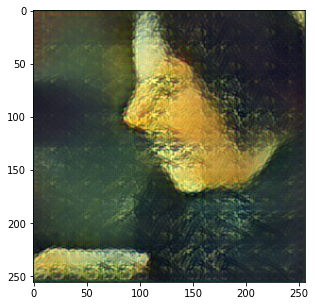

Saved sample stylized image at the_shipwreck/images/sample0_4000.png
========Iteration 4501/10126========
	Content Loss:	1928523.50
	Style Loss:	200420.53
	Total Loss:	2128942.90
Time elapsed:	346.03586411476135 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_4500.pth


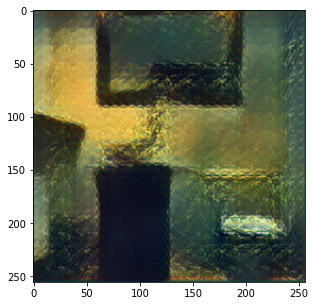

Saved sample stylized image at the_shipwreck/images/sample0_4500.png
========Iteration 5001/10126========
	Content Loss:	1914907.62
	Style Loss:	192450.50
	Total Loss:	2107354.08
Time elapsed:	384.39240550994873 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_5000.pth


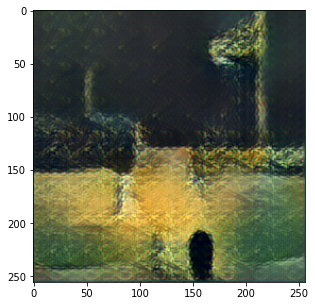

Saved sample stylized image at the_shipwreck/images/sample0_5000.png
========Iteration 5501/10126========
	Content Loss:	1904539.50
	Style Loss:	185927.88
	Total Loss:	2090465.36
Time elapsed:	422.9353108406067 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_5500.pth


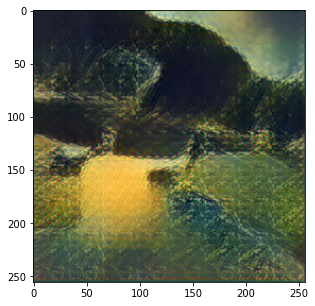

Saved sample stylized image at the_shipwreck/images/sample0_5500.png
========Iteration 6001/10126========
	Content Loss:	1893747.00
	Style Loss:	180539.99
	Total Loss:	2074285.04
Time elapsed:	461.09381079673767 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_6000.pth


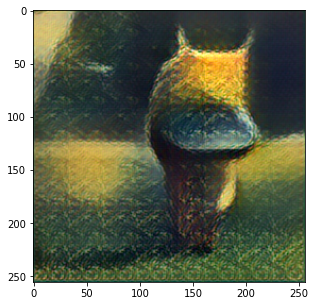

Saved sample stylized image at the_shipwreck/images/sample0_6000.png
========Iteration 6501/10126========
	Content Loss:	1887320.38
	Style Loss:	175923.14
	Total Loss:	2063241.42
Time elapsed:	499.38156628608704 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_6500.pth


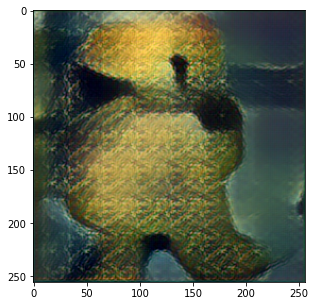

Saved sample stylized image at the_shipwreck/images/sample0_6500.png
========Iteration 7001/10126========
	Content Loss:	1879479.12
	Style Loss:	171977.51
	Total Loss:	2051454.56
Time elapsed:	538.0056807994843 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_7000.pth


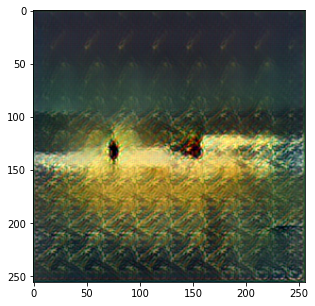

Saved sample stylized image at the_shipwreck/images/sample0_7000.png
========Iteration 7501/10126========
	Content Loss:	1872100.12
	Style Loss:	168587.44
	Total Loss:	2040684.67
Time elapsed:	576.5801448822021 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_7500.pth


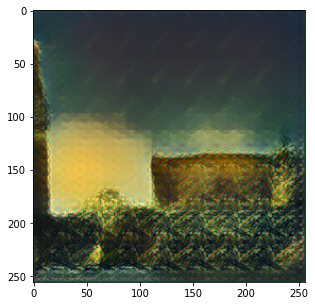

Saved sample stylized image at the_shipwreck/images/sample0_7500.png
========Iteration 8001/10126========
	Content Loss:	1865693.88
	Style Loss:	165623.16
	Total Loss:	2031312.76
Time elapsed:	615.0640366077423 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_8000.pth


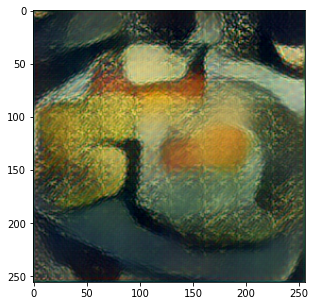

Saved sample stylized image at the_shipwreck/images/sample0_8000.png
========Iteration 8501/10126========
	Content Loss:	1857915.00
	Style Loss:	162991.94
	Total Loss:	2020904.21
Time elapsed:	653.0360820293427 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_8500.pth


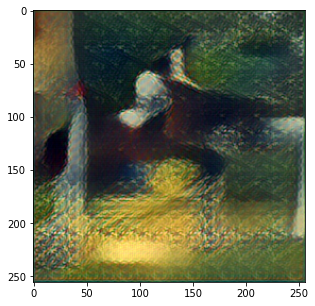

Saved sample stylized image at the_shipwreck/images/sample0_8500.png
========Iteration 9001/10126========
	Content Loss:	1852884.62
	Style Loss:	160634.27
	Total Loss:	2013516.08
Time elapsed:	691.0491824150085 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_9000.pth


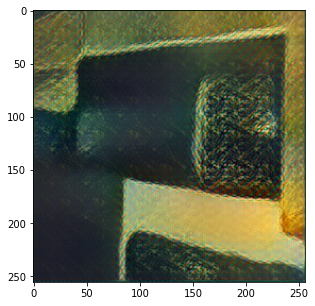

Saved sample stylized image at the_shipwreck/images/sample0_9000.png
========Iteration 9501/10126========
	Content Loss:	1848670.00
	Style Loss:	158554.93
	Total Loss:	2007221.88
Time elapsed:	728.9759867191315 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_9500.pth


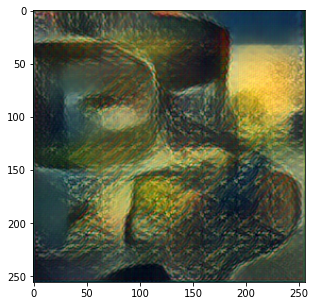

Saved sample stylized image at the_shipwreck/images/sample0_9500.png
========Iteration 10001/10126========
	Content Loss:	1843524.00
	Style Loss:	156664.87
	Total Loss:	2000186.09
Time elapsed:	766.8526358604431 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_10000.pth


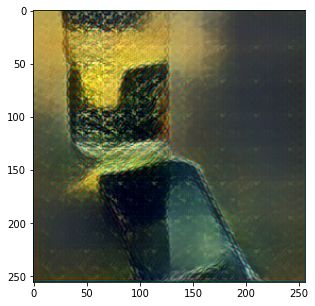

Saved sample stylized image at the_shipwreck/images/sample0_10000.png
========Iteration 10126/10126========
	Content Loss:	1842739.25
	Style Loss:	156223.06
	Total Loss:	1998960.27
Time elapsed:	776.5258791446686 seconds
Saved self trained VGG16 checkpoint file at the_shipwreck/models/checkpoint_10125.pth


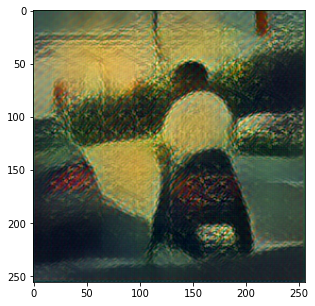

Saved sample stylized image at the_shipwreck/images/sample0_10125.png
Done Training the Network!
Training Time: 776.8464643955231 seconds
========Content Loss========
[11438700.0, 2921514.0978043913, 2560594.332917083, 2409208.467688208, 2317174.270052474, 2256059.5883146743, 2210693.617752416, 2177108.193123393, 2151204.6638027993, 2128942.8969117976, 2107354.0803339332, 2090465.3576395202, 2074285.0444925847, 2063241.418262575, 2051454.5618661619, 2040684.6741101188, 2031312.7647481565, 2020904.2115045288, 2013516.0750055548, 2007221.882222924, 2000186.088478652, 1998960.273540885]
========Style Loss========
[10131635.0, 817202.7034836577, 474005.53338848654, 357731.4596258744, 299156.17570902046, 263754.981307477, 240005.57353017744, 223021.13590536633, 210304.39841406836, 200420.53022765776, 192450.50439912017, 185927.88400404472, 180539.99370157058, 175923.14039666974, 171977.51118143837, 168587.43798535195, 165623.1571551603, 162991.93744485942, 160634.26912895095, 158554.9325473

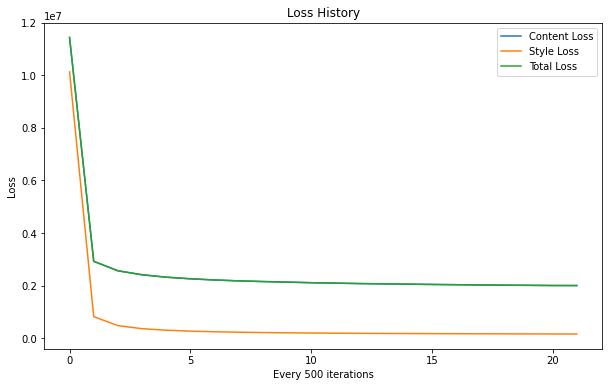

In [22]:
train()

In [23]:
# copy the models folder to the folder in the google drive
!cp -r the_shipwreck/models/ /content/gdrive/My\ Drive/vgg_coco/the_shipwreck/
# copy the images folder to the folder in the google drive
!cp -r the_shipwreck/images/ /content/gdrive/My\ Drive/vgg_coco/the_shipwreck/

## Udnie

In [24]:
# Global variables
TRAIN_IMAGE_SIZE = 256
DATASET_PATH = "train"
NUM_EPOCHS = 1
STYLE_IMAGE_PATH = "style/udnie.jpg"
BATCH_SIZE = 4 
CONTENT_WEIGHT = 10 # 17
STYLE_WEIGHT = 25 # 25
ADAM_LR = 0.001
SAVE_MODEL_PATH = "udnie/models/"
SAVE_IMAGE_PATH = "udnie/images/"
SAVE_MODEL_EVERY = 500 # 2,000 Images with batch size 4
SEED = 35
PLOT_LOSS = 1

========Epoch 1/1========
========Iteration 1/10126========
	Content Loss:	1307065.25
	Style Loss:	10174236.00
	Total Loss:	11481301.00
Time elapsed:	0.1350383758544922 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_0.pth


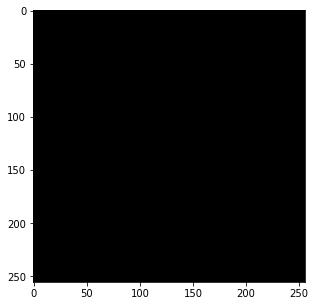

Saved sample stylized image at udnie/images/sample0_0.png
========Iteration 501/10126========
	Content Loss:	2355212.25
	Style Loss:	1143950.20
	Total Loss:	3499163.23
Time elapsed:	38.951841592788696 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_500.pth


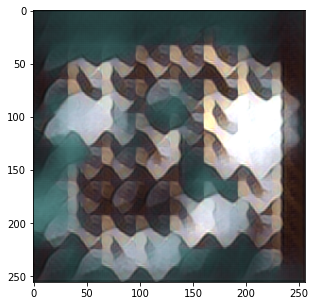

Saved sample stylized image at udnie/images/sample0_500.png
========Iteration 1001/10126========
	Content Loss:	2338272.25
	Style Loss:	696257.33
	Total Loss:	3034529.48
Time elapsed:	76.84135270118713 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_1000.pth


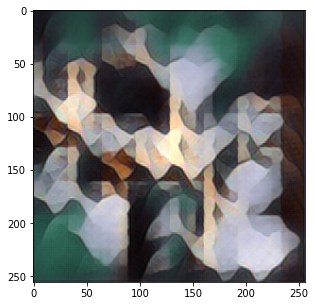

Saved sample stylized image at udnie/images/sample0_1000.png
========Iteration 1501/10126========
	Content Loss:	2299382.50
	Style Loss:	540844.64
	Total Loss:	2840229.62
Time elapsed:	115.22482204437256 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_1500.pth


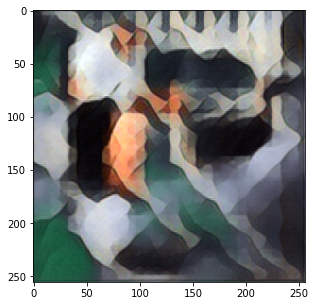

Saved sample stylized image at udnie/images/sample0_1500.png
========Iteration 2001/10126========
	Content Loss:	2260967.00
	Style Loss:	461187.47
	Total Loss:	2722156.86
Time elapsed:	153.11833691596985 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_2000.pth


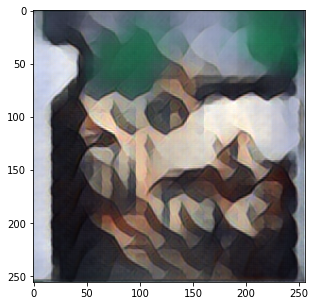

Saved sample stylized image at udnie/images/sample0_2000.png
========Iteration 2501/10126========
	Content Loss:	2229776.75
	Style Loss:	412358.62
	Total Loss:	2642135.82
Time elapsed:	191.18610000610352 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_2500.pth


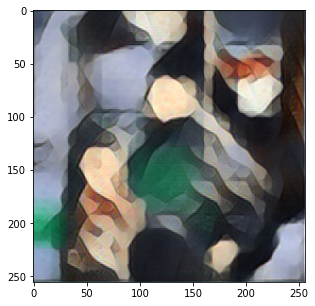

Saved sample stylized image at udnie/images/sample0_2500.png
========Iteration 3001/10126========
	Content Loss:	2202843.25
	Style Loss:	379244.43
	Total Loss:	2582089.69
Time elapsed:	229.11978316307068 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_3000.pth


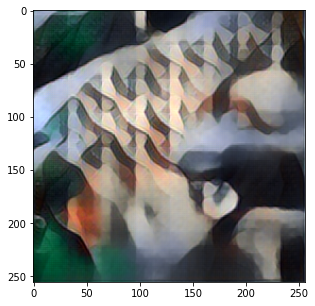

Saved sample stylized image at udnie/images/sample0_3000.png
========Iteration 3501/10126========
	Content Loss:	2180916.50
	Style Loss:	355137.84
	Total Loss:	2536056.16
Time elapsed:	267.3725094795227 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_3500.pth


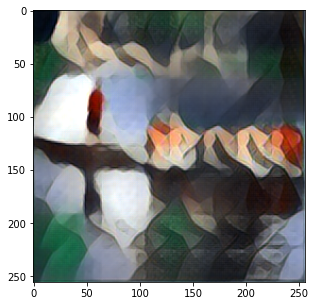

Saved sample stylized image at udnie/images/sample0_3500.png
========Iteration 4001/10126========
	Content Loss:	2162394.50
	Style Loss:	336664.35
	Total Loss:	2499060.07
Time elapsed:	305.6750795841217 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_4000.pth


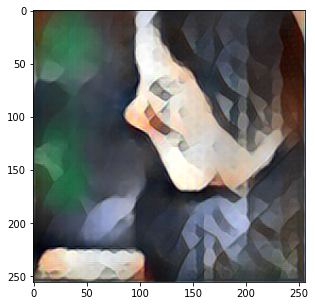

Saved sample stylized image at udnie/images/sample0_4000.png
========Iteration 4501/10126========
	Content Loss:	2144535.50
	Style Loss:	321838.43
	Total Loss:	2466375.83
Time elapsed:	344.13880491256714 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_4500.pth


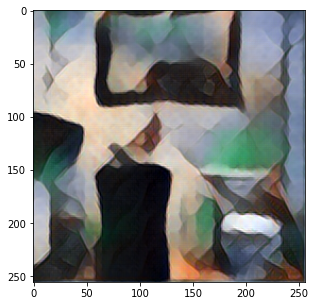

Saved sample stylized image at udnie/images/sample0_4500.png
========Iteration 5001/10126========
	Content Loss:	2126810.75
	Style Loss:	309700.10
	Total Loss:	2436511.33
Time elapsed:	382.3054008483887 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_5000.pth


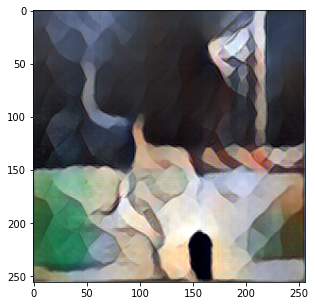

Saved sample stylized image at udnie/images/sample0_5000.png
========Iteration 5501/10126========
	Content Loss:	2112424.50
	Style Loss:	299590.91
	Total Loss:	2412015.66
Time elapsed:	420.8155755996704 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_5500.pth


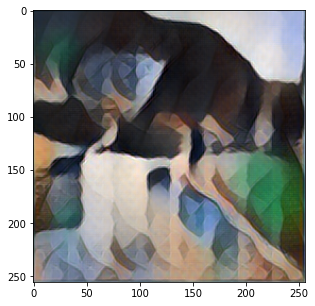

Saved sample stylized image at udnie/images/sample0_5500.png
========Iteration 6001/10126========
	Content Loss:	2097920.75
	Style Loss:	291175.39
	Total Loss:	2389097.27
Time elapsed:	459.04897713661194 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_6000.pth


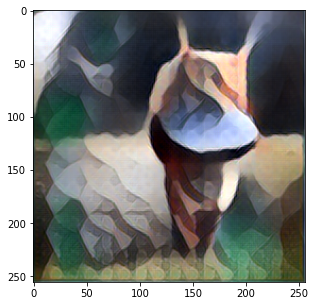

Saved sample stylized image at udnie/images/sample0_6000.png
========Iteration 6501/10126========
	Content Loss:	2087988.12
	Style Loss:	283913.16
	Total Loss:	2371902.45
Time elapsed:	497.1673843860626 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_6500.pth


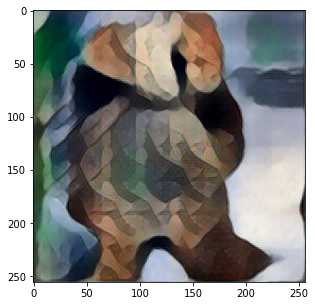

Saved sample stylized image at udnie/images/sample0_6500.png
========Iteration 7001/10126========
	Content Loss:	2077283.50
	Style Loss:	277582.20
	Total Loss:	2354866.59
Time elapsed:	535.4008140563965 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_7000.pth


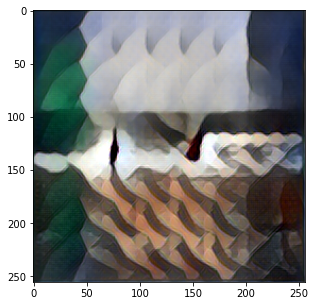

Saved sample stylized image at udnie/images/sample0_7000.png
========Iteration 7501/10126========
	Content Loss:	2066773.88
	Style Loss:	272026.69
	Total Loss:	2338801.09
Time elapsed:	573.6711230278015 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_7500.pth


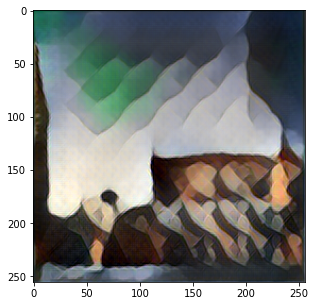

Saved sample stylized image at udnie/images/sample0_7500.png
========Iteration 8001/10126========
	Content Loss:	2057822.88
	Style Loss:	267130.45
	Total Loss:	2324952.12
Time elapsed:	611.9368991851807 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_8000.pth


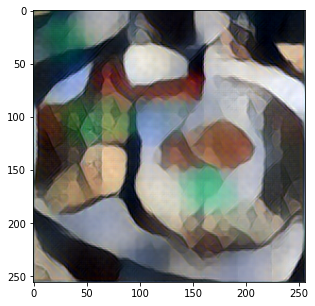

Saved sample stylized image at udnie/images/sample0_8000.png
========Iteration 8501/10126========
	Content Loss:	2047810.00
	Style Loss:	262731.91
	Total Loss:	2310540.24
Time elapsed:	650.0823528766632 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_8500.pth


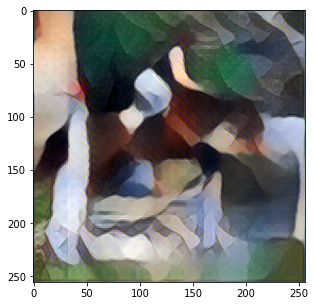

Saved sample stylized image at udnie/images/sample0_8500.png
========Iteration 9001/10126========
	Content Loss:	2040363.12
	Style Loss:	258748.27
	Total Loss:	2299108.91
Time elapsed:	688.1876430511475 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_9000.pth


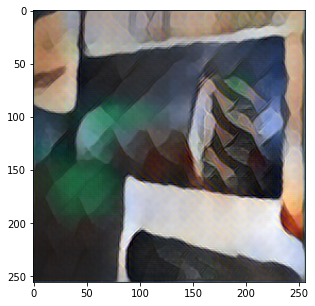

Saved sample stylized image at udnie/images/sample0_9000.png
========Iteration 9501/10126========
	Content Loss:	2034328.62
	Style Loss:	255166.50
	Total Loss:	2289492.74
Time elapsed:	726.3238971233368 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_9500.pth


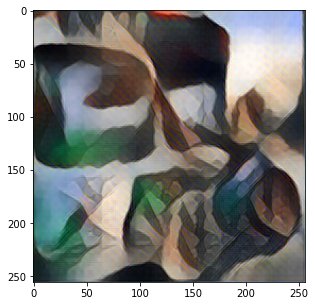

Saved sample stylized image at udnie/images/sample0_9500.png
========Iteration 10001/10126========
	Content Loss:	2027182.75
	Style Loss:	251944.96
	Total Loss:	2279126.27
Time elapsed:	764.3032021522522 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_10000.pth


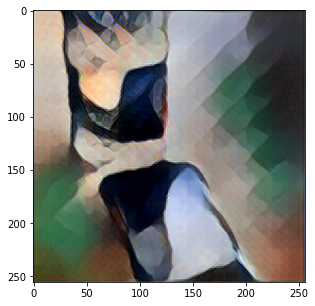

Saved sample stylized image at udnie/images/sample0_10000.png
========Iteration 10126/10126========
	Content Loss:	2025961.00
	Style Loss:	251196.88
	Total Loss:	2277155.62
Time elapsed:	775.0884275436401 seconds
Saved self trained VGG16 checkpoint file at udnie/models/checkpoint_10125.pth


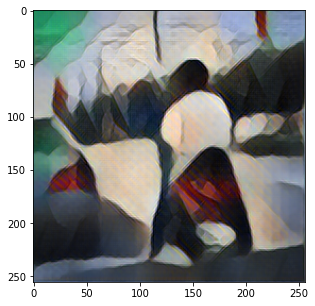

Saved sample stylized image at udnie/images/sample0_10125.png
Done Training the Network!
Training Time: 775.4356722831726 seconds
========Content Loss========
[11481301.0, 3499163.233283433, 3034529.481893107, 2840229.6220852765, 2722156.8634432782, 2642135.820071971, 2582089.6934771743, 2536056.164702942, 2499060.068607848, 2466375.83437014, 2436511.332533493, 2412015.6643337575, 2389097.2708506915, 2371902.454180126, 2354866.5916654766, 2338801.0913044927, 2324952.1182352207, 2310540.2364574755, 2299108.908232419, 2289492.7443295442, 2279126.265473453, 2277155.6207781946]
========Style Loss========
[10174236.0, 1143950.1971681637, 696257.330123002, 540844.6403647568, 461187.46596233133, 412358.6219012395, 379244.42860713095, 355137.842469116, 336664.3481121907, 321838.42799516773, 309700.1037011348, 299590.9144899791, 291175.3857091526, 283913.159660533, 277582.1963893551, 272026.6869938175, 267130.44817249407, 262731.9117089166, 258748.27450595767, 255166.50430382328, 251944.9595040

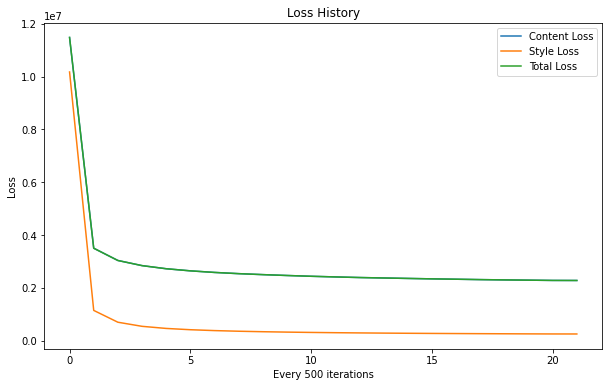

In [25]:
train()

In [26]:
# copy the models folder to the folder in the google drive
!cp -r udnie/models/ /content/gdrive/My\ Drive/vgg_coco/udnie/
# copy the images folder to the folder in the google drive
!cp -r udnie/images/ /content/gdrive/My\ Drive/vgg_coco/udnie/

## Wave

In [27]:
# Global variables
TRAIN_IMAGE_SIZE = 256
DATASET_PATH = "train"
NUM_EPOCHS = 1
STYLE_IMAGE_PATH = "style/wave.jpg"
BATCH_SIZE = 4 
CONTENT_WEIGHT = 10 # 17
STYLE_WEIGHT = 25 # 25
ADAM_LR = 0.001
SAVE_MODEL_PATH = "wave/models/"
SAVE_IMAGE_PATH = "wave/images/"
SAVE_MODEL_EVERY = 500 # 2,000 Images with batch size 4
SEED = 35
PLOT_LOSS = 1

========Epoch 1/1========
========Iteration 1/10126========
	Content Loss:	1307065.25
	Style Loss:	19301274.00
	Total Loss:	20608340.00
Time elapsed:	0.18448257446289062 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_0.pth


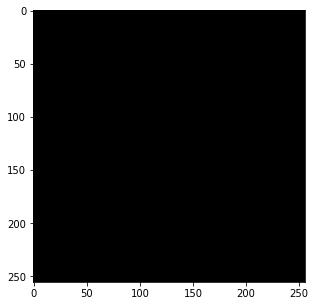

Saved sample stylized image at wave/images/sample0_0.png
========Iteration 501/10126========
	Content Loss:	2816450.00
	Style Loss:	2215869.31
	Total Loss:	5032318.80
Time elapsed:	41.250314712524414 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_500.pth


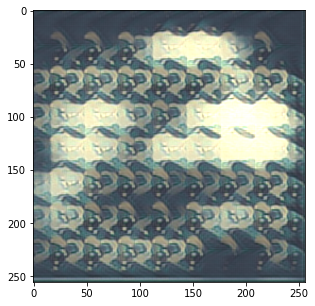

Saved sample stylized image at wave/images/sample0_500.png
========Iteration 1001/10126========
	Content Loss:	2812851.25
	Style Loss:	1236439.65
	Total Loss:	4049292.23
Time elapsed:	81.31176900863647 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_1000.pth


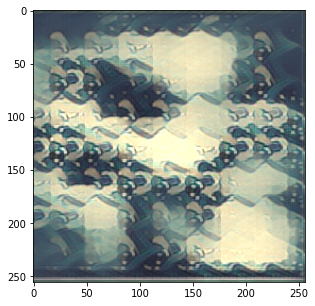

Saved sample stylized image at wave/images/sample0_1000.png
========Iteration 1501/10126========
	Content Loss:	2780432.75
	Style Loss:	904166.43
	Total Loss:	3684601.12
Time elapsed:	121.55085372924805 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_1500.pth


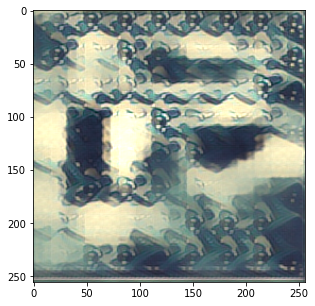

Saved sample stylized image at wave/images/sample0_1500.png
========Iteration 2001/10126========
	Content Loss:	2747102.75
	Style Loss:	736153.13
	Total Loss:	3483257.90
Time elapsed:	161.75691485404968 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_2000.pth


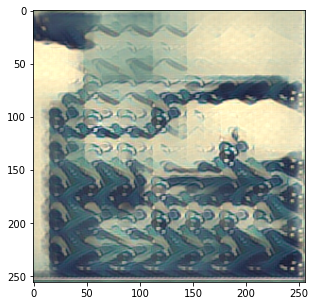

Saved sample stylized image at wave/images/sample0_2000.png
========Iteration 2501/10126========
	Content Loss:	2720281.50
	Style Loss:	634719.43
	Total Loss:	3355004.28
Time elapsed:	202.07381057739258 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_2500.pth


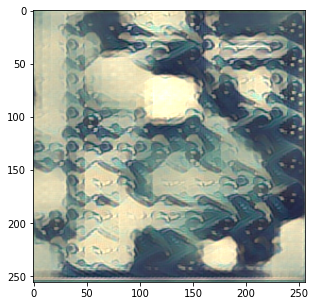

Saved sample stylized image at wave/images/sample0_2500.png
========Iteration 3001/10126========
	Content Loss:	2696576.00
	Style Loss:	566680.93
	Total Loss:	3263259.21
Time elapsed:	242.4046070575714 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_3000.pth


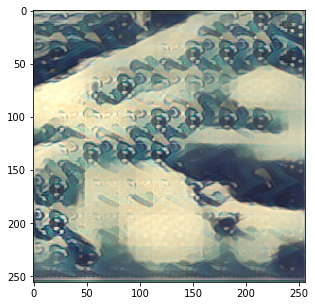

Saved sample stylized image at wave/images/sample0_3000.png
========Iteration 3501/10126========
	Content Loss:	2677360.50
	Style Loss:	517734.73
	Total Loss:	3195099.11
Time elapsed:	282.61964440345764 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_3500.pth


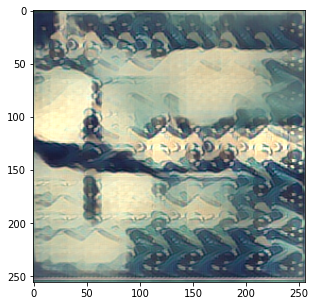

Saved sample stylized image at wave/images/sample0_3500.png
========Iteration 4001/10126========
	Content Loss:	2661064.50
	Style Loss:	480687.11
	Total Loss:	3141750.82
Time elapsed:	322.7920923233032 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_4000.pth


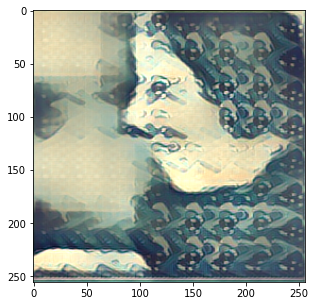

Saved sample stylized image at wave/images/sample0_4000.png
========Iteration 4501/10126========
	Content Loss:	2644777.00
	Style Loss:	451953.14
	Total Loss:	3096728.81
Time elapsed:	362.8625717163086 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_4500.pth


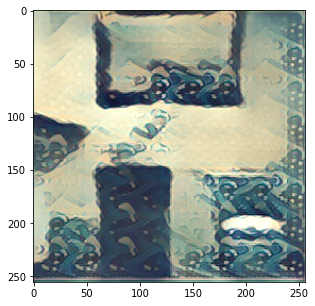

Saved sample stylized image at wave/images/sample0_4500.png
========Iteration 5001/10126========
	Content Loss:	2627768.00
	Style Loss:	428865.45
	Total Loss:	3056632.47
Time elapsed:	403.05888533592224 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_5000.pth


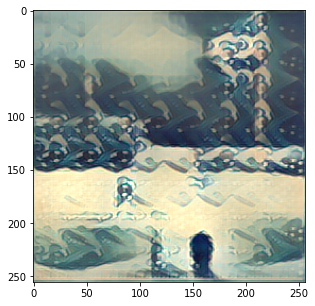

Saved sample stylized image at wave/images/sample0_5000.png
========Iteration 5501/10126========
	Content Loss:	2613467.00
	Style Loss:	409827.10
	Total Loss:	3023293.61
Time elapsed:	443.2024621963501 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_5500.pth


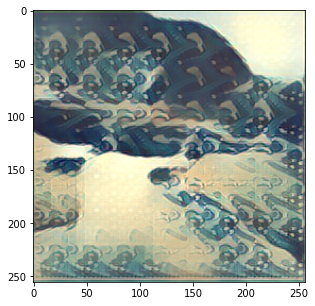

Saved sample stylized image at wave/images/sample0_5500.png
========Iteration 6001/10126========
	Content Loss:	2598968.00
	Style Loss:	394100.87
	Total Loss:	2993071.05
Time elapsed:	483.3836989402771 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_6000.pth


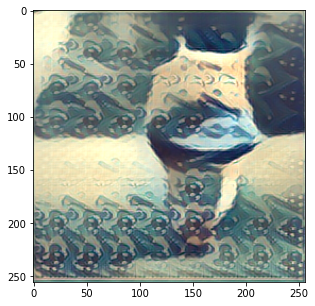

Saved sample stylized image at wave/images/sample0_6000.png
========Iteration 6501/10126========
	Content Loss:	2588905.75
	Style Loss:	380670.00
	Total Loss:	2969578.67
Time elapsed:	523.744039773941 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_6500.pth


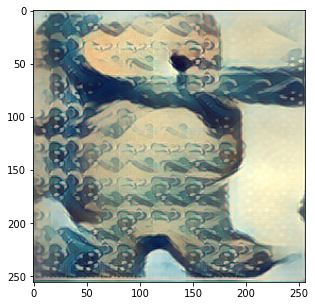

Saved sample stylized image at wave/images/sample0_6500.png
========Iteration 7001/10126========
	Content Loss:	2577794.50
	Style Loss:	369015.28
	Total Loss:	2946810.73
Time elapsed:	563.8184990882874 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_7000.pth


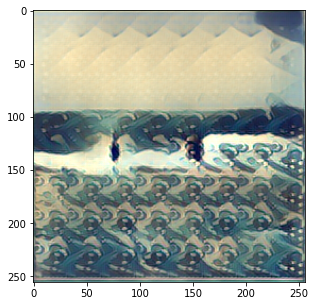

Saved sample stylized image at wave/images/sample0_7000.png
========Iteration 7501/10126========
	Content Loss:	2567195.25
	Style Loss:	358981.78
	Total Loss:	2926178.87
Time elapsed:	604.0237543582916 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_7500.pth


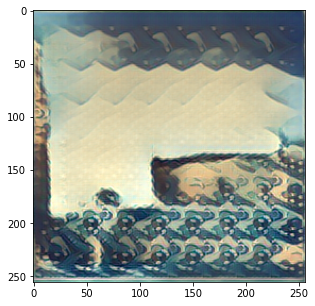

Saved sample stylized image at wave/images/sample0_7500.png
========Iteration 8001/10126========
	Content Loss:	2557676.00
	Style Loss:	350151.27
	Total Loss:	2907829.53
Time elapsed:	643.9599976539612 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_8000.pth


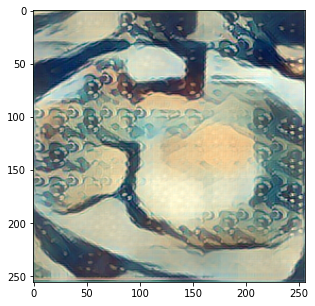

Saved sample stylized image at wave/images/sample0_8000.png
========Iteration 8501/10126========
	Content Loss:	2547273.00
	Style Loss:	342277.04
	Total Loss:	2889548.00
Time elapsed:	683.966860294342 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_8500.pth


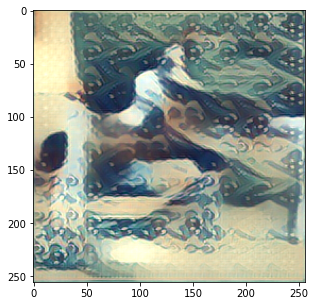

Saved sample stylized image at wave/images/sample0_8500.png
========Iteration 9001/10126========
	Content Loss:	2539306.50
	Style Loss:	335316.07
	Total Loss:	2874619.76
Time elapsed:	724.1083698272705 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_9000.pth


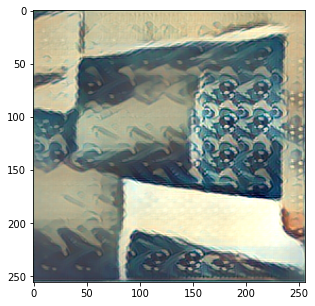

Saved sample stylized image at wave/images/sample0_9000.png
========Iteration 9501/10126========
	Content Loss:	2532313.50
	Style Loss:	329082.25
	Total Loss:	2861392.45
Time elapsed:	764.4310820102692 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_9500.pth


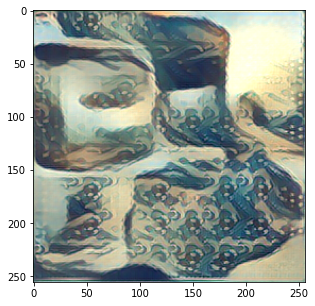

Saved sample stylized image at wave/images/sample0_9500.png
========Iteration 10001/10126========
	Content Loss:	2524762.25
	Style Loss:	323458.88
	Total Loss:	2848221.76
Time elapsed:	804.7674651145935 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_10000.pth


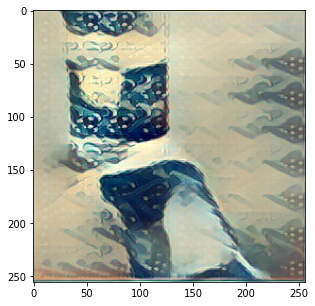

Saved sample stylized image at wave/images/sample0_10000.png
========Iteration 10126/10126========
	Content Loss:	2523369.50
	Style Loss:	322143.30
	Total Loss:	2845513.57
Time elapsed:	815.348217010498 seconds
Saved self trained VGG16 checkpoint file at wave/models/checkpoint_10125.pth


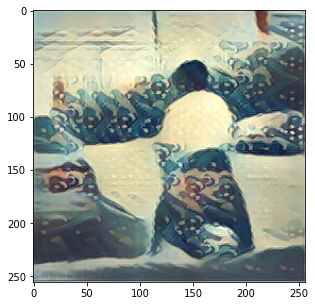

Saved sample stylized image at wave/images/sample0_10125.png
Done Training the Network!
Training Time: 815.67773604393 seconds
========Content Loss========
[20608340.0, 5032318.802894211, 4049292.227272727, 3684601.1170886075, 3483257.9025487257, 3355004.2849860056, 3263259.2070143283, 3195099.110896887, 3141750.821732067, 3096728.813013775, 3056632.4681313736, 3023293.607730413, 2993071.047075487, 2969578.673857868, 2946810.730431367, 2926178.8697840287, 2907829.5251374827, 2889547.9958975413, 2874619.761832019, 2861392.451228818, 2848221.7628737125, 2845513.574930871]
========Style Loss========
[19301274.0, 2215869.3057634733, 1236439.6469624126, 904166.4349392072, 736153.1280765868, 634719.4335453318, 566680.9318924942, 517734.72527492145, 480687.114811141, 451953.14444706735, 428865.45195023494, 409827.10266315215, 394100.8738777912, 380670.0021679357, 369015.2775898086, 358981.77880449273, 350151.2681129702, 342277.03734119516, 335316.0732314465, 329082.24611060676, 323458.8837788

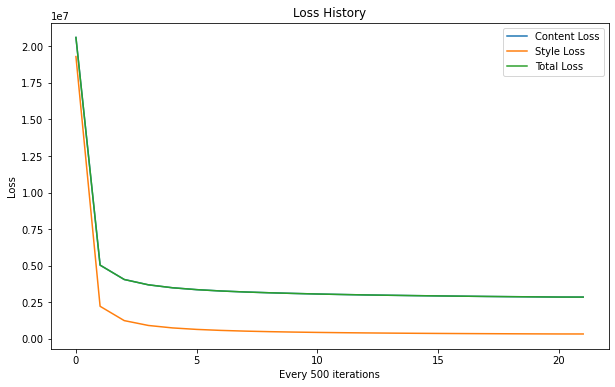

In [28]:
train()

In [29]:
# copy the models folder to the folder in the google drive
!cp -r wave/models/ /content/gdrive/My\ Drive/vgg_coco/wave/
# copy the images folder to the folder in the google drive
!cp -r wave/images/ /content/gdrive/My\ Drive/vgg_coco/wave/